# MANUAL NET ARCHITECTURE

In [1]:
import warnings
warnings.filterwarnings('ignore')

In [2]:
import os
import glob
import numpy as np

from tensorflow.keras.preprocessing.image import ImageDataGenerator

from tensorflow.keras.models import Sequential
from PIL import Image

from tensorflow.keras.layers import Convolution2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Activation

from keras.callbacks import ModelCheckpoint
import matplotlib.pyplot as plt

In [3]:
Anthracnose = 'DATASET/TRAIN/Anthracnose'
Apple_Scab = 'DATASET/TRAIN/Apple_Scab'
Crown_Gall = 'DATASET/TRAIN/Crown_Gall'
Brown_Rot = 'DATASET/TRAIN/Brown_Rot'

In [4]:
def plot_images(item_dir, n=6):
    all_item_dir = os.listdir(item_dir)
    item_files = [os.path.join(item_dir, file) for file in all_item_dir][:n]
    
    plt.figure(figsize=(80, 40))
    for idx, img_path in enumerate(item_files):
        plt.subplot(3, n, idx+1)
        img = plt.imread(img_path)
        plt.imshow(img, cmap='gray')
        plt.axis('off')
    
    plt.tight_layout()
    
def image_details_print(data,path):
    print('======== Images in: ', path)
    for key,values in data.items():
        print(key,':\t', values)


def images_details(path):
    files=[f for f in glob.glob(path + "**/*.*", recursive=True)]
    data={}
    data['Images_count']=len(files)
    data['Min_width']=10**100
    data['Max_width']=0
    data['Min_height']=10**100
    data['Max_height']=0
    
    for f in files:
        img=Image.open(f)
        width,height=img.size
        data['Min_width']=min(width,data['Min_width'])
        data['Max_width']=max(width, data['Max_width'])
        data['Min_height']=min(height, data['Min_height'])
        data['Max_height']=max(height, data['Max_height'])
        
    image_details_print(data,path)


TRAINING DATA FOR Anthracnose:

======== Images in:  DATASET/TRAIN/Anthracnose
Images_count :	 360
Min_width :	 285
Max_width :	 5184
Min_height :	 225
Max_height :	 3456



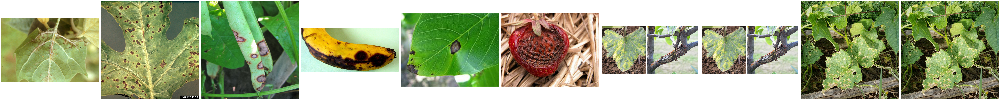

In [5]:
print("")
print("TRAINING DATA FOR Anthracnose:")
print("")
images_details(Anthracnose)
print("")
plot_images(Anthracnose, 10) 


TRAINING DATA FOR Apple_Scab:

======== Images in:  DATASET/TRAIN/Apple_Scab
Images_count :	 372
Min_width :	 115
Max_width :	 4032
Min_height :	 85
Max_height :	 4160



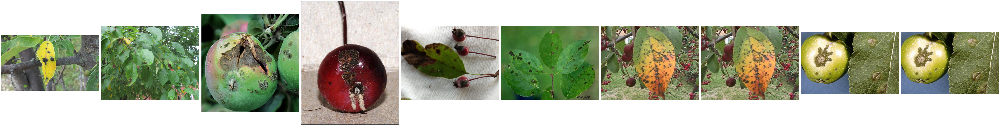

In [6]:
print("")
print("TRAINING DATA FOR Apple_Scab:")
print("")
images_details(Apple_Scab)
print("")
plot_images(Apple_Scab, 10)


TRAINING DATA FOR Crown_Gall:

======== Images in:  DATASET/TRAIN/Crown_Gall
Images_count :	 380
Min_width :	 150
Max_width :	 2500
Min_height :	 133
Max_height :	 3333



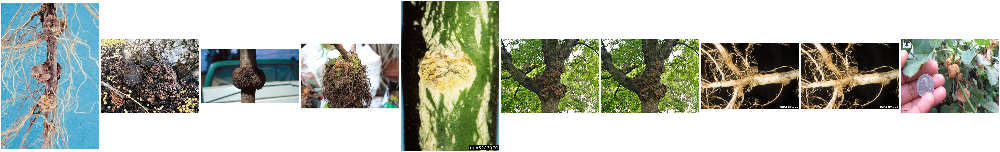

In [7]:
print("")
print("TRAINING DATA FOR Crown_Gall:")
print("")
images_details(Crown_Gall)
print("")
plot_images(Crown_Gall, 10)


TRAINING DATA FOR Crown_Gall:

======== Images in:  DATASET/TRAIN/Crown_Gall
Images_count :	 380
Min_width :	 150
Max_width :	 2500
Min_height :	 133
Max_height :	 3333



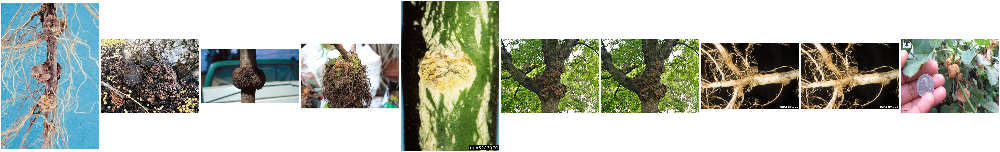

In [8]:
print("")
print("TRAINING DATA FOR Crown_Gall:")
print("")
images_details(Crown_Gall)
print("")
plot_images(Crown_Gall, 10)

In [9]:
train_datagen=ImageDataGenerator(rescale=1./255,shear_range=0.2,zoom_range=0.2,horizontal_flip=True)
training_set=train_datagen.flow_from_directory('dataset/train',target_size=(224,224),batch_size=32,class_mode='categorical')

Found 4326 images belonging to 12 classes.


In [10]:
test_datagen=ImageDataGenerator(rescale=1./255)
test_set=test_datagen.flow_from_directory('dataset/test',target_size=(224,224),batch_size=32,class_mode='categorical')

Found 1200 images belonging to 12 classes.


In [11]:
Classifier=Sequential()
Classifier.add(Convolution2D(32,(3,3),input_shape=(224,224,3),activation='relu'))
Classifier.add(MaxPooling2D(pool_size=(2,2)))
Classifier.add(Flatten())
Classifier.add(Dense(38, activation='relu'))
Classifier.add(Dense(12, activation='softmax'))
Classifier.compile(optimizer='rmsprop',loss='categorical_crossentropy',metrics=['accuracy'])

In [12]:
model_path = "MANUAL.h5"

callbacks = [
    ModelCheckpoint(model_path, monitor='accuracy', verbose=1, save_best_only=True)
]

In [13]:
epochs = 10
batch_size = 512

In [14]:
#### Fitting the model
history = Classifier.fit(
           training_set, steps_per_epoch=training_set.samples // batch_size, 
           epochs=epochs, 
           validation_data=test_set,validation_steps=test_set.samples // batch_size,
           callbacks=callbacks)

Epoch 1/10


8/8 [==============================] - ETA: 0s - loss: 50.0070 - accuracy: 0.0781
Epoch 1: accuracy improved from -inf to 0.07812, saving model to MANUAL.h5
8/8 [==============================] - 10s 1s/step - loss: 50.0070 - accuracy: 0.0781 - val_loss: 8.1943 - val_accuracy: 0.1094
Epoch 2/10
8/8 [==============================] - ETA: 0s - loss: 4.1425 - accuracy: 0.0742
Epoch 2: accuracy did not improve from 0.07812
8/8 [==============================] - 8s 1s/step - loss: 4.1425 - accuracy: 0.0742 - val_loss: 2.5397 - val_accuracy: 0.1250
Epoch 3/10
8/8 [==============================] - ETA: 0s - loss: 2.5119 - accuracy: 0.1211
Epoch 3: accuracy improved from 0.07812 to 0.12109, saving model to MANUAL.h5
8/8 [==============================] - 8s 1s/step - loss: 2.5119 - accuracy: 0.1211 - val_loss: 2.4624 - val_accuracy: 0.1406
Epoch 4/10
8/8 [==============================] - ETA: 0s - loss: 2.4800 - accuracy: 0.0586
Epoch 4: accuracy did not improve from 0.12109
8/

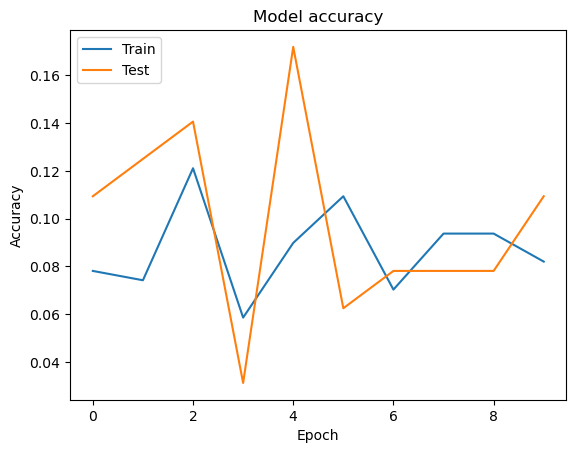

In [15]:
import matplotlib.pyplot as plt

def graph():
    #Plot training & validation accuracy values
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()

graph()

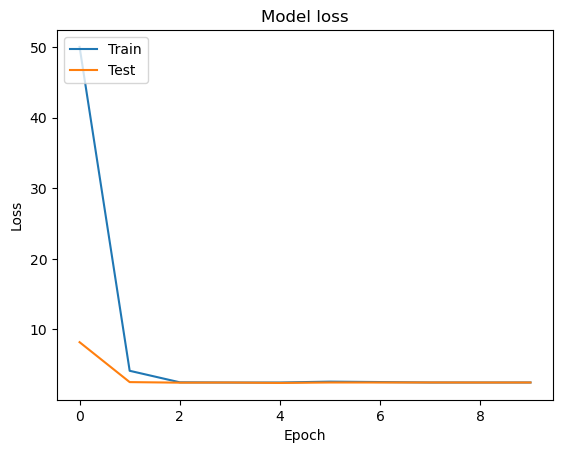

In [16]:
import matplotlib.pyplot as plt

def graph():
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()
graph()